<a href="https://colab.research.google.com/github/marekpaulik/Pytorch/blob/main/Cassava2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
! pip install -q kaggle

In [2]:
from google.colab import files
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"marekpaulik77","key":"45a85395b9430e554cac34582f3daabb"}'}

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
! mkdir ~/.kaggle
! cp kaggle.json ~/.kaggle
! chmod 600 ~/.kaggle/kaggle.json
!pip install --upgrade --force-reinstall --no-deps kaggle

     |████████████████████████████████| 61kB 7.9MB/s 
  Created wheel for kaggle: filename=kaggle-1.5.12-cp37-none-any.whl size=73053 sha256=66a7b53f573e4e47af4a948dc6643e838c89b61f6f49c8bf1d67a0da40ce439a
  Stored in directory: /root/.cache/pip/wheels/a1/6a/26/d30b7499ff85a4a4593377a87ecf55f7d08af42f0de9b60303
Successfully built kaggle
  Found existing installation: kaggle 1.5.12
    Uninstalling kaggle-1.5.12:
      Successfully uninstalled kaggle-1.5.12


In [5]:
!kaggle competitions download -c cassava-disease

100% 2.30G/2.30G [00:29<00:00, 23.9MB/s]
100% 2.30G/2.30G [00:29<00:00, 82.7MB/s]


In [6]:
! mkdir train
! unzip cassava-disease.zip -d train

Archive:  cassava-disease.zip
  inflating: train/extraimages.zip   
  inflating: train/random.txt        
  inflating: train/sample_submission_file.csv  
  inflating: train/test.zip          
  inflating: train/train.zip         


In [7]:
! unzip -q train/train.zip -d train

In [8]:
! mkdir test
! unzip -q train/test.zip -d test

In [1]:
! pip install efficientnet_pytorch --q

In [2]:
import numpy as np 
import pandas as pd
import json
from PIL import Image
import os
import matplotlib.pyplot as plt
from collections import Counter


import torch
import torch.nn as nn
import torchvision
import torchvision.transforms as T
from torch.utils.data import Dataset, DataLoader, random_split, WeightedRandomSampler
from torch.utils.tensorboard import SummaryWriter

from efficientnet_pytorch import EfficientNet


from tqdm import tqdm

Callbacks

In [22]:
# Early stopping
class EarlyStopping:
  def __init__(self, patience=3, delta=0, path='checkpoint.pt'):
    self.patience = patience
    self.delta = delta
    self.path= path
    self.counter = 0
    self.best_score = None
    self.early_stop = False

  def __call__(self, val_loss, model):
    if self.best_score is None:
      self.best_score = val_loss
      self.save_checkpoint(model)
    elif val_loss > self.best_score:
      self.counter +=1
      if self.counter >= self.patience:
        self.early_stop = True 
    else:
      self.best_score = val_loss
      self.save_checkpoint(model)
      self.counter = 0      

  def save_checkpoint(self, model):
    torch.save(model.state_dict(), self.path)



Load data (create dataloaders)


In [18]:
def load_data(data_dir, Transform, sample, batch_size):
  train_full = torchvision.datasets.ImageFolder(data_dir, transform=Transform)
  train_set, val_set = random_split(train_full, [5000, 656]) #TODO parametrize

  if sample:
    # Need to get weight for every image in the dataset
    train_classes = [label for _, label in train_set]
    class_count = Counter(train_classes)
    class_weights = torch.tensor([5000/class_count[0], 5000/class_count[1],
                          5000/class_count[2], 5000/class_count[3],
                          5000/class_count[4]]) #TODO parametrize

    sample_weights = [0] * len(train_set)
    for idx, (image, label) in enumerate(train_set):
      class_weight = class_weights[label]
      sample_weights[idx] = class_weight

    sampler = WeightedRandomSampler(weights=sample_weights,
                                    num_samples = len(train_set), replacement=True)  
    train_loader = DataLoader(train_set, batch_size=batch_size, sampler=sampler)
  else:
    train_loader = DataLoader(train_set, batch_size=batch_size, shuffle=True)

  val_loader = DataLoader(val_set, batch_size=batch_size)

  return train_loader, val_loader    

Load model, criterion, optimizer

In [30]:
def load_model(arch, num_classes, lr, loss_weights, freeze_backbone, device):
  if arch == 'resnet':
    model = torchvision.models.resnet50(pretrained=True)
  elif arch == 'efficient-net':
    model = EfficientNet.from_pretrained('efficientnet-b7')

  if freeze_backbone:
    for param in model.parameters():
      param.requires_grad = False

  model.fc = nn.Linear(in_features=model.fc.in_features, out_features=num_classes)
  model = model.to(device)

  optimizer = torch.optim.Adam(model.parameters(), lr) 

  if loss_weights:
    train_classes = [label for _, label in train_set]  #TODO need to send train_set to load_model or change
    class_count = Counter(train_classes)
    class_weights = torch.tensor([5000/class_count[0], 5000/class_count[1],
                          5000/class_count[2], 5000/class_count[3],
                          5000/class_count[4]]) #TODO parametrize
    class_weights = class_weights.to(device)  
    criterion = nn.CrossEntropyLoss(class_weights)
  else:
    criterion = nn.CrossEntropyLoss() 
  
  return model, optimizer, criterion   

Train function

In [32]:
def train(model, criterion, optimizer, num_epochs, use_amp, freeze_backbone,
          unfreeze_after, tensorboard, stop_early, device, train_loader, val_loader):
  if tensorboard:
    writer = SummaryWriter('runs/sampler_cassava') #TODO parametrize
  if stop_early:
    early_stopping = EarlyStopping(
    patience=5, 
    path='/content/drive/My Drive/ColabNotebooks/Cassava/sampler_checkpoint.pt') #TODO parametrize
  
  num_epochs = num_epochs
  step_train = 0
  step_val = 0

  scaler = torch.cuda.amp.GradScaler(enabled=use_amp)

  for epoch in range(num_epochs):
    if freeze_backbone:
      if epoch == unfreeze_after:  # Unfreeze after x epochs
        for param in model.parameters():
          param.requires_grad = True

    train_loss = list() # Every epoch check average loss per batch 
    train_acc = list()
    model.train()
    for i, (images, targets) in enumerate(tqdm(train_loader)):
      images = images.to(device)
      targets = targets.to(device)

      with torch.cuda.amp.autocast(enabled=use_amp): #mixed precision
        logits = model(images)
        loss = criterion(logits, targets)

      scaler.scale(loss).backward()
      scaler.step(optimizer)
      scaler.update()

      optimizer.zero_grad()

      train_loss.append(loss.item())

      #Calculate running train accuracy
      predictions = torch.argmax(logits, dim=1)
      num_correct = sum(predictions.eq(targets))
      running_train_acc = float(num_correct) / float(images.shape[0])
      train_acc.append(running_train_acc)

      # Plot to tensorboard
      if tensorboard:
        img_grid = torchvision.utils.make_grid(images[:10])
        writer.add_image('Cassava_images', img_grid) # Check how transformed images look in training
        writer.add_histogram('fc', model.fc.weight) # Check if our weights change during trianing

        writer.add_scalar('training_loss', loss, global_step=step_train)
        writer.add_scalar('training_acc', running_train_acc, global_step=step_train)
        step_train +=1

    print(f'Epoch {epoch}/{num_epochs-1}')  
    print(f'Training loss: {torch.tensor(train_loss).mean():.2f}') 

    val_losses = list()
    val_accs = list()
    model.eval()
    with torch.no_grad():
      for (images, targets) in val_loader:
        images = images.to(device)
        targets = targets.to(device)

        with torch.cuda.amp.autocast(enabled=use_amp):
          logits = model(images)
          loss = criterion(logits, targets)
        val_losses.append(loss.item())      
        
        predictions = torch.argmax(logits, dim=1)
        num_correct = sum(predictions.eq(targets))
        running_val_acc = float(num_correct) / float(images.shape[0])

        val_accs.append(running_val_acc)
        
        if tensorboard:
          writer.add_scalar('validation_loss', loss, global_step=step_val)
          writer.add_scalar('validation_acc', running_val_acc, global_step=step_val)
          step_val +=1

      val_loss = torch.tensor(val_losses).mean()
      val_acc = torch.tensor(val_accs).mean() # Average acc per batch
      
      print(f'Validation loss: {val_loss:.2f}')  
      print(f'Validation accuracy: {val_acc:.2f}') 
      
      if stop_early:
        early_stopping(val_loss, model)
        if early_stopping.early_stop:
          print('Early Stopping')
          print(f'Best validation loss: {early_stopping.best_score}')
          break


In [33]:
def main(num_classes, device, data_dir='train/train', Transform=None, sample=False, loss_weights=False,
         batch_size=64, lr=1e-4, arch='resnet', tensorboard=True,
         stop_early=True, use_amp=True, freeze_backbone=True, num_epochs=10, unfreeze_after=5):
  
  train_loader, val_loader = load_data(data_dir, Transform=Transform,
                                       sample=sample, batch_size=batch_size)
  
  model, optimizer, criterion = load_model(arch=arch, num_classes=num_classes,
                                lr=lr, loss_weights=loss_weights,
                                freeze_backbone=freeze_backbone, device=device)

  train(model=model, optimizer=optimizer, criterion=criterion, num_epochs=num_epochs, freeze_backbone=freeze_backbone,
        unfreeze_after=unfreeze_after, tensorboard=tensorboard,
        stop_early=stop_early, use_amp=use_amp, device=device, train_loader=train_loader,
        val_loader=val_loader)
  

In [34]:
Transform = T.Compose(
    [T.ToTensor(),
     T.Resize((256, 256)),
     T.RandomRotation(90),
     T.RandomHorizontalFlip(p=0.5),
     T.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))])

device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

main(Transform=Transform, sample=True, num_classes=5, device=device)

100%|██████████| 79/79 [02:26<00:00,  1.86s/it]


Epoch 0/9
Training loss: 1.52
Validation loss: 1.33
Validation accuracy: 0.60


100%|██████████| 79/79 [02:27<00:00,  1.87s/it]


Epoch 1/9
Training loss: 1.33


  0%|          | 0/79 [00:00<?, ?it/s]

Validation loss: 1.33
Validation accuracy: 0.49


100%|██████████| 79/79 [02:26<00:00,  1.85s/it]


Epoch 2/9
Training loss: 1.22
Validation loss: 1.22
Validation accuracy: 0.53


100%|██████████| 79/79 [02:27<00:00,  1.87s/it]


Epoch 3/9
Training loss: 1.15
Validation loss: 1.21
Validation accuracy: 0.49


100%|██████████| 79/79 [02:26<00:00,  1.85s/it]


Epoch 4/9
Training loss: 1.11
Validation loss: 1.09
Validation accuracy: 0.59


100%|██████████| 79/79 [02:45<00:00,  2.10s/it]


Epoch 5/9
Training loss: 0.61
Validation loss: 0.74
Validation accuracy: 0.76


100%|██████████| 79/79 [02:47<00:00,  2.12s/it]


Epoch 6/9
Training loss: 0.44
Validation loss: 0.58
Validation accuracy: 0.81


100%|██████████| 79/79 [02:48<00:00,  2.13s/it]


Epoch 7/9
Training loss: 0.33
Validation loss: 0.54
Validation accuracy: 0.82


100%|██████████| 79/79 [02:50<00:00,  2.16s/it]


Epoch 8/9
Training loss: 0.30


  0%|          | 0/79 [00:00<?, ?it/s]

Validation loss: 0.63
Validation accuracy: 0.79


100%|██████████| 79/79 [02:49<00:00,  2.14s/it]


Epoch 9/9
Training loss: 0.24
Validation loss: 0.62
Validation accuracy: 0.81


In [ ]:
# Plot an example
def deprocess(img):
  img = img.permute(1,2,0)
  img = img * torch.Tensor([0.229, 0.224, 0.225]) + torch.Tensor([0.485, 0.456, 0.406])
  return img


images, targets = next(iter(train_loader))

img = images[0]

plt.imshow(deprocess(img))

In [35]:
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

Plot Validation set predictions

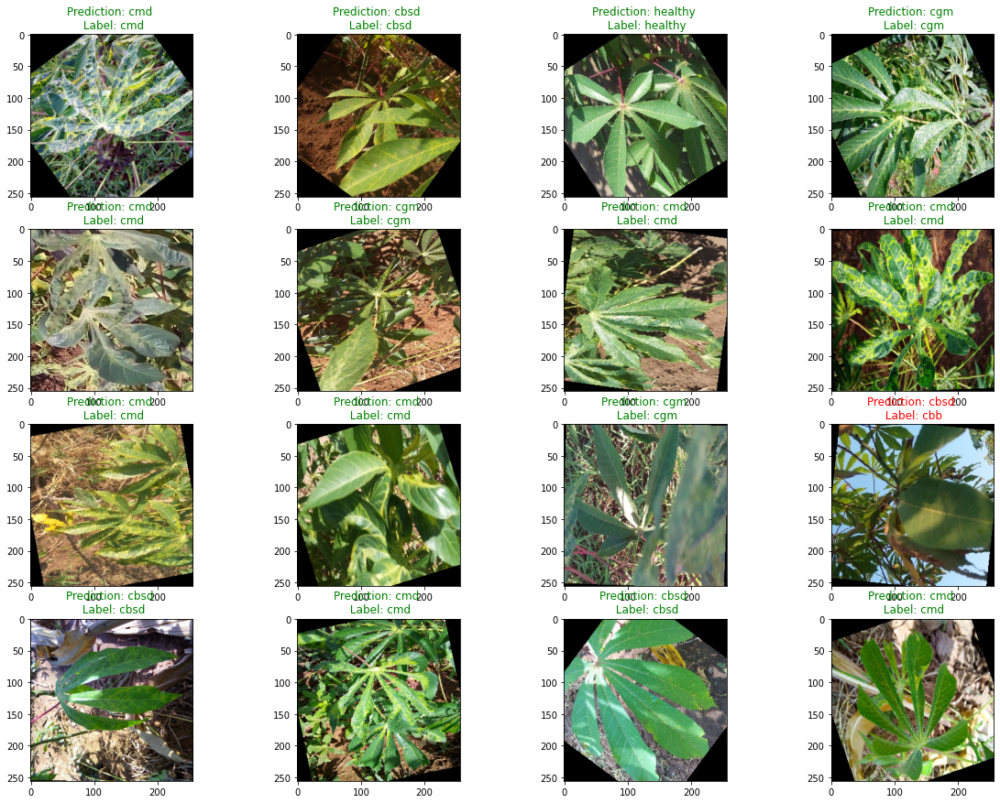

In [ ]:
# Plots predictions on last batch
# Does this work after changes?


mapping = {0:'cbb', 1:'cbsd', 2:'cgm', 3:'cmd', 4:'healthy'}

fig = plt.figure(figsize=(20,15))
images = images.to('cpu')

for i in range(len(images)):
  ax = fig.add_subplot(4,4, i+1)
  plt.imshow(deprocess(images[i]))
  pred = pd.Series(predictions.to('cpu').numpy()).map(mapping)[i]
  label = pd.Series(targets.to('cpu').numpy()).map(mapping)[i]
  ax.set_title(f'Prediction: {pred} \n Label: {label}',
                    color=('green' if pred==label else 'red'))



## Inference

In [ ]:
model.load_state_dict(torch.load('/content/drive/My Drive/ColabNotebooks/Cassava/sampler_checkpoint.pt'))

<All keys matched successfully>

In [ ]:
class Cassava_Test(Dataset):
  def __init__(self, dir, transform=None):
    self.dir = dir
    self.transform = transform

    self.images = os.listdir(self.dir)  

  def __len__(self):
    return len(self.images)

  def __getitem__(self, idx):
    img = Image.open(os.path.join(self.dir, self.images[idx]))
    return self.transform(img), self.images[idx]    

In [ ]:
test_set = Cassava_Test('test/test/0', transform=Transform)
test_loader = DataLoader(test_set, batch_size=4)

In [ ]:
sub = pd.DataFrame(columns=['category', 'id'])
id_list = []
pred_list = []

model = model.to(device)

with torch.no_grad():
  for (image, image_id) in test_loader:
    image = image.to(device)

    logits = model(image)
    predicted = list(torch.argmax(logits, 1).cpu().numpy())

    for id in image_id:
      id_list.append(id)
  
    for prediction in predicted:
      pred_list.append(prediction)
sub['category'] = pred_list
sub['id'] = id_list
     


In [ ]:
#mapping = {0:'cbb', 1:'cbsd', 2:'cgm', 3:'cmd', 4:'healthy'}

sub['category'] = sub['category'].map(mapping)
sub = sub.sort_values(by='id')

In [ ]:
sub.head()

,category,id
1464,cbsd,test-img-0.jpg
2698,cbsd,test-img-1.jpg
392,cmd,test-img-10.jpg
3029,cgm,test-img-100.jpg
1447,cbsd,test-img-1000.jpg


In [ ]:
sub.to_csv('Cassava_sub.csv', index=False)

GIT